In [1]:
!pip install LibRecommender
!pip install surprise
!pip install comet_ml
!pip install seaborn
!pip install wordcloud


  Using cached LibRecommender-0.6.10.tar.gz (457 kB)
  Using cached cachetools-4.2.4-py3-none-any.whl (10 kB)
  Created wheel for LibRecommender: filename=LibRecommender-0.6.10-cp38-cp38-win_amd64.whl size=219000 sha256=6be1741bf1afdb2f3cb3292c4d934613e49b2ef5d899ebc3f2bd9480953a6817
  Stored in directory: c:\users\admin\appdata\local\pip\cache\wheels\fc\1d\70\246a7add96308cbe0b2b44d40de717ad7d95e9b98996452286
  Created wheel for termcolor: filename=termcolor-1.1.0-py3-none-any.whl size=4829 sha256=9a7cc9aa05369b3334661d2bbfaf05aac768663eac43ce27f5831b9492f7a842
  Stored in directory: c:\users\admin\appdata\local\pip\cache\wheels\a0\16\9c\5473df82468f958445479c59e784896fa24f4a5fc024b0f501
Successfully built LibRecommender termcolor
  Attempting uninstall: importlib-metadata
    Found existing installation: importlib-metadata 3.10.0
    Uninstalling importlib-metadata-3.10.0:
      Successfully uninstalled importlib-metadata-3.10.0


In [7]:
!pip install plotly

In [9]:
!pip install cufflinks

  Created wheel for cufflinks: filename=cufflinks-0.17.3-py3-none-any.whl size=68724 sha256=36620d04033eb9abec909a102b892d8405665a476faa8396b605aa0f42c5affa
  Stored in directory: c:\users\admin\appdata\local\pip\cache\wheels\6b\76\62\6da97734911ffcbdd559fd1a3f28526321f0ae699182a23866
Successfully built cufflinks


In [10]:
import warnings
warnings.simplefilter(action='ignore')

import pandas as pd
import numpy as np
import re

# visualisation libraries
from plotly.offline import init_notebook_mode, plot, iplot
import plotly.graph_objs as go
import matplotlib.pyplot as plt
from wordcloud import WordCloud, STOPWORDS
import seaborn as sns
import matplotlib


# Data Preprocessing
import cufflinks as cf
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

from sklearn.model_selection import train_test_split

# Modelling
from surprise import Reader, Dataset
from surprise import SVD, SVDpp, NormalPredictor, BaselineOnly, NMF, SlopeOne, CoClustering, KNNWithMeans
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer

# Performance Evaluation
from surprise import accuracy
from sklearn.metrics import mean_squared_error
from surprise.model_selection import GridSearchCV, cross_validate, train_test_split

#extra 
from itertools import permutations
import heapq
import pickle

In [12]:

g_scores_df = pd.read_csv('genome_scores.csv')
g_tags_df = pd.read_csv('genome_tags.csv')
imdb_df = pd.read_csv('imdb_data.csv')
links_df = pd.read_csv('links.csv')
movies_df = pd.read_csv('movies.csv')
tags_df = pd.read_csv('tags.csv')
test_df = pd.read_csv('test.csv')
train_df = pd.read_csv('train.csv')


#We won't be making use of all the data available to us, 
#we'll import values that we find interesting

movies = movies_df
imdb_data = imdb_df
tags = tags_df
train = train_df
test = test_df

In [13]:
pd.set_option("display.max_rows", None, "display.max_columns", None)

In [14]:
#check the shape of the data
shape = {'Genome scores': g_scores_df.shape,
            'Genome tags': g_tags_df.shape,
            'IMDB': imdb_df.shape,
            'Links': links_df.shape,
            "Movies": movies_df.shape,
            'Tags': tags_df.shape,
            'Train': train_df.shape,
            'Test': test_df.shape}

df_shape = pd.DataFrame(list(shape.items()), columns=['Data Frame', 'Shape'])
df_shape

,Data Frame,Shape
0,Genome scores,"(15584448, 3)"
1,Genome tags,"(1128, 2)"
2,IMDB,"(27278, 6)"
3,Links,"(62423, 3)"
4,Movies,"(62423, 3)"
5,Tags,"(1093360, 4)"
6,Train,"(10000038, 4)"
7,Test,"(5000019, 2)"


In [15]:
#show full value of dataframe
pd.set_option("display.max_rows", None, "display.max_columns", None)

# Display the first 5 entries in each dataframe 
display(movies_df.head())
display(imdb_df.head())
display(tags_df.head())
display(train_df.head())

# Count the number of unique entries for features of interest
unique_movies = len(movies_df['movieId'].unique().tolist())
unique_tags = len(tags_df['tag'].unique().tolist())
unique_users = len(train_df['userId'].unique().tolist())
unique_directors = len(imdb_df['director'].unique().tolist())
unique_actors = len(imdb_df['title_cast'].unique().tolist())

# Create a dataframe to store the number of unique entries for features of interest
unique = pd.DataFrame({"movies": [unique_movies],
                       "tags" : [unique_tags],
                       "users": [unique_users],
                       "directors" : [unique_directors],
                       "actors" : [unique_actors]}, index=['unique_entries'])

print('number of unique entries for features of interest')
display(unique.transpose())

# Determine and display the min and max ratings received
min_rating = train_df.rating.min()
max_rating = train_df.rating.max()
print('Lowest rating: {}'.format(min_rating))
print('Highest rating: {}'.format(max_rating))

,movieId,title,genres
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
1,2,Jumanji (1995),Adventure|Children|Fantasy
2,3,Grumpier Old Men (1995),Comedy|Romance
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance
4,5,Father of the Bride Part II (1995),Comedy


,movieId,title_cast,director,runtime,budget,plot_keywords
0,1,Tom Hanks|Tim Allen|Don Rickles|Jim Varney|Wal...,John Lasseter,81.0,"$30,000,000",toy|rivalry|cowboy|cgi animation
1,2,Robin Williams|Jonathan Hyde|Kirsten Dunst|Bra...,Jonathan Hensleigh,104.0,"$65,000,000",board game|adventurer|fight|game
2,3,Walter Matthau|Jack Lemmon|Sophia Loren|Ann-Ma...,Mark Steven Johnson,101.0,"$25,000,000",boat|lake|neighbor|rivalry
3,4,Whitney Houston|Angela Bassett|Loretta Devine|...,Terry McMillan,124.0,"$16,000,000",black american|husband wife relationship|betra...
4,5,Steve Martin|Diane Keaton|Martin Short|Kimberl...,Albert Hackett,106.0,"$30,000,000",fatherhood|doberman|dog|mansion


,userId,movieId,tag,timestamp
0,3,260,classic,1439472355
1,3,260,sci-fi,1439472256
2,4,1732,dark comedy,1573943598
3,4,1732,great dialogue,1573943604
4,4,7569,so bad it's good,1573943455


,userId,movieId,rating,timestamp
0,5163,57669,4.0,1518349992
1,106343,5,4.5,1206238739
2,146790,5459,5.0,1076215539
3,106362,32296,2.0,1423042565
4,9041,366,3.0,833375837


number of unique entries for features of interest


,unique_entries
movies,62423
tags,73051
users,162541
directors,11787
actors,17144


Lowest rating: 0.5
Highest rating: 5.0


In [16]:
# We create a dataframe that merges all the features that we think might help us in solving the problem
df = imdb_data[['movieId','title_cast','director', 'plot_keywords']]
df = df.merge(movies[['movieId', 'genres', 'title']], on='movieId', how='inner')
#Add colummn for release year
df['year'] = df['title'].str.extract(r"\((\d+)\)", expand=False)
df.head()

,movieId,title_cast,director,plot_keywords,genres,title,year
0,1,Tom Hanks|Tim Allen|Don Rickles|Jim Varney|Wal...,John Lasseter,toy|rivalry|cowboy|cgi animation,Adventure|Animation|Children|Comedy|Fantasy,Toy Story (1995),1995
1,2,Robin Williams|Jonathan Hyde|Kirsten Dunst|Bra...,Jonathan Hensleigh,board game|adventurer|fight|game,Adventure|Children|Fantasy,Jumanji (1995),1995
2,3,Walter Matthau|Jack Lemmon|Sophia Loren|Ann-Ma...,Mark Steven Johnson,boat|lake|neighbor|rivalry,Comedy|Romance,Grumpier Old Men (1995),1995
3,4,Whitney Houston|Angela Bassett|Loretta Devine|...,Terry McMillan,black american|husband wife relationship|betra...,Comedy|Drama|Romance,Waiting to Exhale (1995),1995
4,5,Steve Martin|Diane Keaton|Martin Short|Kimberl...,Albert Hackett,fatherhood|doberman|dog|mansion,Comedy,Father of the Bride Part II (1995),1995


In [17]:
# Merge train with movies to join movie titles and ratings 
ratings = train_df.merge(movies_df, on='movieId', how='inner')

In [18]:
# Convert data types to strings for string handling
df['title_cast'] = df.title_cast.astype(str)
df['plot_keywords'] = df.plot_keywords.astype(str)
df['genres'] = df.genres.astype(str)
df['director'] = df.director.astype(str)

# Removing spaces between names
df['director'] = df['director'].apply(lambda x: "".join(x.lower() for x in x.split()))
df['title_cast'] = df['title_cast'].apply(lambda x: "".join(x.lower() for x in x.split()))

# Discarding the pipes between the actors' full names and getting only the first three names
df['title_cast'] = df['title_cast'].map(lambda x: x.split('|')[:3])

# Discarding the pipes between the plot keywords' and getting only the first five words
df['plot_keywords'] = df['plot_keywords'].map(lambda x: x.split('|')[:5])
df['plot_keywords'] = df['plot_keywords'].apply(lambda x: " ".join(x))

# Discarding the pipes between the genres 
df['genres'] = df['genres'].map(lambda x: x.lower().split('|'))
df['genres'] = df['genres'].apply(lambda x: " ".join(x))

df.head()

,movieId,title_cast,director,plot_keywords,genres,title,year
0,1,"[tomhanks, timallen, donrickles]",johnlasseter,toy rivalry cowboy cgi animation,adventure animation children comedy fantasy,Toy Story (1995),1995
1,2,"[robinwilliams, jonathanhyde, kirstendunst]",jonathanhensleigh,board game adventurer fight game,adventure children fantasy,Jumanji (1995),1995
2,3,"[waltermatthau, jacklemmon, sophialoren]",markstevenjohnson,boat lake neighbor rivalry,comedy romance,Grumpier Old Men (1995),1995
3,4,"[whitneyhouston, angelabassett, lorettadevine]",terrymcmillan,black american husband wife relationship betra...,comedy drama romance,Waiting to Exhale (1995),1995
4,5,"[stevemartin, dianekeaton, martinshort]",alberthackett,fatherhood doberman dog mansion,comedy,Father of the Bride Part II (1995),1995


In [23]:
# Total Number of ratings by the top 10 Users
tot_rating = train_df['userId'].value_counts().head(10).sum()
tot_movies = train_df["movieId"].nunique()
print("These Top 10 Users have provided a total of " + str(tot_rating) + " ratings together for " + str(tot_movies) + " movies")

These Top 10 Users have provided a total of 38970 ratings together for 48213 movies


In [24]:
# Extract and display the 10 most popular films in the dataset 
# Determine the average rating and number of ratings for each movie
ratings_mean_count = pd.DataFrame(ratings.groupby(['title'])[['rating']].mean())
ratings_mean_count['rating_counts'] = pd.DataFrame(ratings.groupby(['title'])['rating'].count())
ratings_mean_count['popularity'] = pd.DataFrame(ratings.groupby(['title'])['rating'].count()*ratings.groupby(['title'])['rating'].mean())

ratings_mean_count = ratings_mean_count.sort_values(by='popularity', ascending=False).head(10)
ratings_mean_count.head(10)

,rating,rating_counts,popularity
title,,,
"Shawshank Redemption, The (1994)",4.417624,32831,145035.0
Pulp Fiction (1994),4.195097,31697,132972.0
Forrest Gump (1994),4.047216,32383,131061.0
"Silence of the Lambs, The (1991)",4.144172,29444,122021.0
"Matrix, The (1999)",4.154253,29014,120531.5
Star Wars: Episode IV - A New Hope (1977),4.111811,27560,113321.5
Schindler's List (1993),4.247625,24004,101960.0
Fight Club (1999),4.227906,23536,99508.0
Star Wars: Episode V - The Empire Strikes Back (1980),4.146236,22956,95181.0


In [72]:
# Count how many ratings are in each category (1 star, 2 star, ect)
grouped = pd.DataFrame(ratings.groupby(['rating'])['title'].count())
grouped.rename(columns={'title':'rating_count'}, inplace=True)


In [34]:
user_ratings = train[['userId','rating',"movieId"]]
user_ratings = user_ratings.merge(movies[['title',"movieId"]], on='movieId', how='inner')
user_ratings = user_ratings.drop(['movieId'], axis = 1)
user_ratings = user_ratings.head(750000) #reducing values

In [35]:
def space_remover(df, columns):
    """
    Removes spaces from the string values

    Parameters
    ----------
    df (DataFrame): Input DataFrame
    column (String): List of columns to be preprocessed

    Returns
    ----------
    DataFrame: Processed DataFrame with spaces removed
    """
    for i in columns:
        df[i] = df[i].str.replace(' ', '')

    return df

In [36]:
space_remover(df, ['title_cast', 'director', 'plot_keywords', 'genres'])

,movieId,title_cast,director,plot_keywords,genres,title,year
0,1,tomhankstimallendonrickles,johnlasseter,toyrivalrycowboycgianimation,adventureanimationchildrencomedyfantasy,Toy Story (1995),1995
1,2,robinwilliamsjonathanhydekirstendunst,jonathanhensleigh,boardgameadventurerfightgame,adventurechildrenfantasy,Jumanji (1995),1995
2,3,waltermatthaujacklemmonsophialoren,markstevenjohnson,boatlakeneighborrivalry,comedyromance,Grumpier Old Men (1995),1995
3,4,whitneyhoustonangelabassettlorettadevine,terrymcmillan,blackamericanhusbandwiferelationshipbetrayalmo...,comedydramaromance,Waiting to Exhale (1995),1995
4,5,stevemartindianekeatonmartinshort,alberthackett,fatherhooddobermandogmansion,comedy,Father of the Bride Part II (1995),1995
5,6,alpacinorobertdenirovalkilmer,michaelmann,gunbattleorganizedcrimehonorcriminalinvestigation,actioncrimethriller,Heat (1995),1995
6,7,harrisonfordjuliaormondgregkinnear,samuela.taylor,characternameastitlechauffeurestateplayboy,comedyromance,Sabrina (1995),1995
7,8,jonathantaylorthomasbradrenfroericschweig,marktwain,rescuefromdrowningneardrowningcharacternamesas...,adventurechildren,Tom and Huck (1995),1995
8,9,jean-claudevandammepowersbootheraymondj.barry,karenelisebaldwin,hockeydeathintitletwowordtitleterrorist,action,Sudden Death (1995),1995
9,10,piercebrosnanseanbeanizabellascorupco,ianfleming,officialjamesbondseriesjamesbondcharacter007ch...,actionadventurethriller,GoldenEye (1995),1995


In [37]:
def data_preprocessor(df, columns):
    """
    Replces '|' with a space ' ' found within the dataset.
    Change all string values into lower case

    Parameters
    ----------
    df (DataFrame): Input DataFrame
    column (String): List of columns to be preprocessed

    Returns
    ----------
    DataFrame: Processed DataFrame with '|' replaced with spaces 

    """
    for i in columns:
        df[i] = df[i].str.replace('|', ' ')
        df[i] = df[i].str.lower()
    return df

In [38]:
data_preprocessor(df, ['genres', 'title_cast', 'plot_keywords'])

,movieId,title_cast,director,plot_keywords,genres,title,year
0,1,tomhankstimallendonrickles,johnlasseter,toyrivalrycowboycgianimation,adventureanimationchildrencomedyfantasy,Toy Story (1995),1995
1,2,robinwilliamsjonathanhydekirstendunst,jonathanhensleigh,boardgameadventurerfightgame,adventurechildrenfantasy,Jumanji (1995),1995
2,3,waltermatthaujacklemmonsophialoren,markstevenjohnson,boatlakeneighborrivalry,comedyromance,Grumpier Old Men (1995),1995
3,4,whitneyhoustonangelabassettlorettadevine,terrymcmillan,blackamericanhusbandwiferelationshipbetrayalmo...,comedydramaromance,Waiting to Exhale (1995),1995
4,5,stevemartindianekeatonmartinshort,alberthackett,fatherhooddobermandogmansion,comedy,Father of the Bride Part II (1995),1995
5,6,alpacinorobertdenirovalkilmer,michaelmann,gunbattleorganizedcrimehonorcriminalinvestigation,actioncrimethriller,Heat (1995),1995
6,7,harrisonfordjuliaormondgregkinnear,samuela.taylor,characternameastitlechauffeurestateplayboy,comedyromance,Sabrina (1995),1995
7,8,jonathantaylorthomasbradrenfroericschweig,marktwain,rescuefromdrowningneardrowningcharacternamesas...,adventurechildren,Tom and Huck (1995),1995
8,9,jean-claudevandammepowersbootheraymondj.barry,karenelisebaldwin,hockeydeathintitletwowordtitleterrorist,action,Sudden Death (1995),1995
9,10,piercebrosnanseanbeanizabellascorupco,ianfleming,officialjamesbondseriesjamesbondcharacter007ch...,actionadventurethriller,GoldenEye (1995),1995


In [39]:
# Creating an empty column and list to store the corpus for each movie
#df['Year'] = df['Year'].astype(str)
df['corpus'] = ''
corpus = []

# List of the columns we want to use to create our corpus 
columns = ['plot_keywords', 'genres', 'year']

# For each movie, combine the contents of the selected columns to form it's unique corpus 
for i in range(0, len(df['movieId'])):
    words = ''
    for col in columns:
        words = words + str(df.iloc[i][col]) + " "        
    corpus.append(words)

# Add the corpus information for each movie to the dataframe 
df['corpus'] = corpus
df.set_index('movieId', inplace=True)

# Drop the columns we don't need anymore to preserve memory
df.drop(columns=['title_cast', 'director', 'plot_keywords', 'genres', 'year'], inplace=True)


df.head(10)

,title,corpus
movieId,,
1,Toy Story (1995),toyrivalrycowboycgianimation adventureanimatio...
2,Jumanji (1995),boardgameadventurerfightgame adventurechildren...
3,Grumpier Old Men (1995),boatlakeneighborrivalry comedyromance 1995
4,Waiting to Exhale (1995),blackamericanhusbandwiferelationshipbetrayalmo...
5,Father of the Bride Part II (1995),fatherhooddobermandogmansion comedy 1995
6,Heat (1995),gunbattleorganizedcrimehonorcriminalinvestigat...
7,Sabrina (1995),characternameastitlechauffeurestateplayboy com...
8,Tom and Huck (1995),rescuefromdrowningneardrowningcharacternamesas...
9,Sudden Death (1995),hockeydeathintitletwowordtitleterrorist action...


In [40]:
titles = df['title']
indices = pd.Series(df.index, index=df['title'])

In [41]:
cv = CountVectorizer()
count_matrix = cv.fit_transform(df['corpus'])

In [42]:
cos_sim_cv = cosine_similarity(count_matrix, count_matrix)
print(cos_sim_cv.shape)

(24866, 24866)


In [47]:
def content_generate_rating_estimate(title, user, rating_data, k=20, threshold=0.0):
    # Convert the movie title to a numeric index for our 
    # similarity matrix
    m_idx = indices[title]
    neighbors = [] # <-- Stores our collection of similarity values 
     
    # Gather the similarity ratings between each book the user has rated
    # and the reference book 
    for index, row in user_ratings[user_ratings['userId']==user].iterrows():
        sim = cos_sim_cv[m_idx-1, indices[row['title']]-1]
        neighbors.append((sim, row['rating']))
    # Select the top-N values from our collection
    k_neighbors = heapq.nlargest(k, neighbors, key=lambda t: t[0])

    # Compute the weighted average using similarity scores and 
    # user item ratings. 
    simTotal, weightedSum = 0, 0
    for (simScore, rating) in k_neighbors:
        # Ensure that similarity ratings are above a given threshold
        if (simScore > threshold):
            simTotal += simScore
            weightedSum += simScore * rating
    try:
        predictedRating = weightedSum / simTotal
    except ZeroDivisionError:
        # Cold-start problem - No ratings given by user. 
        # We use the average rating for the reference item as a proxy in this case 
        predictedRating = np.mean(user_ratings[user_ratings['title']==title]['rating'])
    return predictedRating

In [49]:
movie_title = "Glory (1989)"
actual_rating = user_ratings[(user_ratings['userId'] == 8) & (user_ratings['title'] == movie_title)]['rating'].values[0]
pred_rating = content_generate_rating_estimate(title=movie_title, user=8, rating_data=user_ratings)
print (f"Title - {movie_title}")
print ("---")
print (f"Actual rating: \t\t {actual_rating}")
print (f"Predicted rating: \t {pred_rating}")

Title - Glory (1989)
---
Actual rating: 		 5.0
Predicted rating: 	 4.226497308103743


User-user collaborative based filtering

In [51]:
# Creating a small test dataframe to evaluate our models
tests = train.copy()
tests.drop(['timestamp'], axis=1, inplace=True)
tests = tests.head(10000)

# Creating the training data
reader = Reader(rating_scale=(0.5, 5))
test_data = Dataset.load_from_df(tests[['userId','movieId','rating']], reader)

# Compute similarities between users using cosine distance
sim_options = {"name": "cosine",
               "user_based": True}  

# Evaluate the model 
user = KNNWithMeans(sim_options=sim_options)
cv = cross_validate(user, test_data, cv=5, measures=['RMSE'], verbose=True)

Computing the cosine similarity matrix...
Done computing similarity matrix.
Computing the cosine similarity matrix...
Done computing similarity matrix.
Computing the cosine similarity matrix...
Done computing similarity matrix.
Computing the cosine similarity matrix...
Done computing similarity matrix.
Computing the cosine similarity matrix...
Done computing similarity matrix.
Evaluating RMSE of algorithm KNNWithMeans on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    1.1187  1.1184  1.0932  1.1081  1.1068  1.1090  0.0094  
Fit time          1.57    1.58    1.55    1.66    1.60    1.59    0.04    
Test time         0.03    0.02    0.02    0.02    0.03    0.02    0.01    


Item-Item collaborative based filtering

In [52]:
# Compute similarities between items using cosine distance
sim_options = {"name": "cosine",
               "user_based": False}  

# Fit the KNNwithmeans algorithm to the training set
item_based = KNNWithMeans(sim_options=sim_options)

# Evaluate the model 
cv = cross_validate(item_based, test_data, cv=5, measures=['RMSE'], verbose=True)

Computing the cosine similarity matrix...
Done computing similarity matrix.
Computing the cosine similarity matrix...
Done computing similarity matrix.
Computing the cosine similarity matrix...
Done computing similarity matrix.
Computing the cosine similarity matrix...
Done computing similarity matrix.
Computing the cosine similarity matrix...
Done computing similarity matrix.
Evaluating RMSE of algorithm KNNWithMeans on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    1.1008  1.0587  1.0857  1.0755  1.1192  1.0880  0.0207  
Fit time          0.29    0.32    0.35    0.41    0.32    0.34    0.04    
Test time         0.02    0.02    0.02    0.01    0.02    0.02    0.01    


In [53]:
# Load the 100k dataset
train.drop('timestamp', axis=1, inplace=True)
train_subset = train[:100000]
reader = Reader(rating_scale=(train_subset['rating'].min(), train_subset['rating'].max()))
data = Dataset.load_from_df(train_subset[['userId', 'movieId', 'rating']], reader)
trainset, testset = train_test_split(data, test_size=.25, random_state=42)

In [54]:
svd_sub = SVD()
svd_sub.fit(trainset)
svd_pred = svd_sub.test(testset)

# Model Preformance

svd_rmse = accuracy.rmse(svd_pred)

RMSE: 0.9826


In [55]:
svdpp_sub = SVDpp()
svdpp_sub.fit(trainset)
svdpp_pred = svdpp_sub.test(testset)

# Model Preformance

svdpp_rmse = accuracy.rmse(svdpp_pred)

RMSE: 0.9801


In [56]:
np_sub = NormalPredictor()
np_sub.fit(trainset)
np_pred = np_sub.test(testset)

# Model Performance

np_rmse = accuracy.rmse(np_pred)

RMSE: 1.4607


In [57]:
bsl_options = {'method':'sgd', 'n_epochs':40}

blo_sub = BaselineOnly(bsl_options=bsl_options)
blo_sub.fit(trainset)
blo_pred = blo_sub.test(testset)

# Model Performance

blo_rmse = accuracy.rmse(blo_pred)

Estimating biases using sgd...
RMSE: 0.9735


In [58]:
nmf_sub = NMF()
nmf_sub.fit(trainset)
nmf_pred = nmf_sub.test(testset)

# Model Performance

nmf_rmse = accuracy.rmse(nmf_pred)

RMSE: 1.1612


In [59]:
so_sub = SlopeOne()
so_sub.fit(trainset)
so_pred = so_sub.test(testset)

# Model Performance

so_rmse = accuracy.rmse(so_pred)

RMSE: 1.1598


In [60]:
cc_sub = CoClustering(random_state=42)
cc_sub.fit(trainset)
cc_pred = cc_sub.test(testset)

# Model Performance

cc_rmse = accuracy.rmse(cc_pred)

RMSE: 1.1514


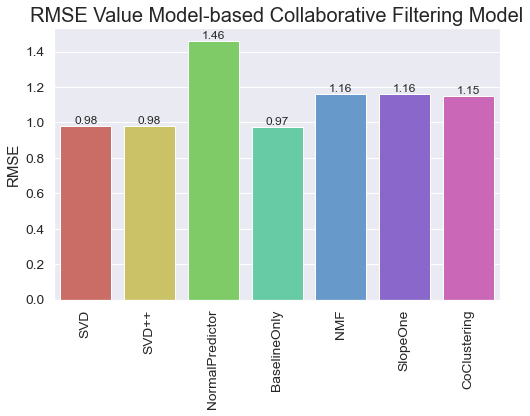

In [61]:
# Compare RMSE values between models
fig,axis = plt.subplots(figsize=(8, 5))
rmse_x = ['SVD','SVD++','NormalPredictor','BaselineOnly','NMF','SlopeOne','CoClustering']
rmse_y = [svd_rmse,svdpp_rmse,np_rmse,blo_rmse,nmf_rmse,so_rmse,cc_rmse]
ax = sns.barplot(x=rmse_x, y=rmse_y,palette='hls')
plt.title('RMSE Value Model-based Collaborative Filtering Model',fontsize=20)
plt.xticks(rotation=90)
plt.ylabel('RMSE')
for p in ax.patches:
    ax.text(p.get_x() + p.get_width()/2, p.get_y() + p.get_height(), round(p.get_height(),2), fontsize=12, ha="center", va='bottom')
    
plt.show()

In [62]:
svd = SVD()
# Run 5-fold cross-validation and print results
svd_cv = cross_validate(svd, data, measures=['RMSE'], cv=5, verbose=True)

Evaluating RMSE of algorithm SVD on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    0.9732  0.9766  0.9803  0.9831  0.9795  0.9785  0.0034  
Fit time          6.47    6.59    6.58    6.33    6.46    6.48    0.09    
Test time         0.16    0.17    0.16    0.14    0.15    0.16    0.01    


In [63]:
svdpp = SVDpp()
# Run 5-fold cross-validation and print results
svdpp_cv = cross_validate(svdpp, data, measures=['RMSE'], cv=5, verbose=True)

Evaluating RMSE of algorithm SVDpp on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    0.9634  0.9762  0.9800  0.9687  0.9833  0.9743  0.0073  
Fit time          12.25   11.54   11.44   11.68   11.58   11.70   0.28    
Test time         0.30    0.29    0.29    0.30    0.29    0.29    0.00    


In [64]:
bsl_options = {'method':'sgd', 'n_epochs':40}
blo = BaselineOnly(bsl_options=bsl_options)

# Run 5-fold cross-validation and print results
blo_cv = cross_validate(blo, data, measures=['RMSE'], cv=5, verbose=True)


Estimating biases using sgd...
Estimating biases using sgd...
Estimating biases using sgd...
Estimating biases using sgd...
Estimating biases using sgd...
Evaluating RMSE of algorithm BaselineOnly on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    0.9729  0.9739  0.9594  0.9657  0.9669  0.9678  0.0053  
Fit time          1.72    1.60    1.68    1.83    1.73    1.71    0.07    
Test time         0.21    0.45    0.14    0.39    0.12    0.26    0.13    


In [71]:
#  DO NOT run this cell. It will run for 2-3 hours

param_grid = {'n_epochs':[30,40,50], 
              'n_factors':[200,300,400], 
              'init_std_dev':[0.001, 0.005, 0.05, 0.1], 
              'random_state':[42]} 
grid_SVD = GridSearchCV(SVD, cv=5, measures=['rmse'], param_grid=param_grid, n_jobs=-1, joblib_verbose=10)
grid_SVD.fit(data)
print('Best Score is: ')
print(grid_SVD.best_score['rmse'])
print('Best Parameters are: ')
print(grid_SVD.best_params['rmse'])
# n_epochs = 40, n_factors = 400, init_std_dev = 0.005, random_state=42

In [66]:
svd_test = SVD(n_epochs = 40, n_factors = 400, init_std_dev = 0.005, random_state=42)
svd_test.fit(trainset)
predictions = svd_test.test(testset)
# Calculate RMSE
svd_rmse = accuracy.rmse(predictions)

RMSE: 0.9734


In [68]:
# Train model on whole dataset
reader = Reader(rating_scale=(train_df['rating'].min(), train_df['rating'].max()))
data = Dataset.load_from_df(train_df[['userId', 'movieId', 'rating']], reader)
trainset = data.build_full_trainset()
svd = SVD(n_epochs = 40, n_factors = 400, init_std_dev = 0.005, random_state=42, verbose=True)
svd.fit(trainset)

# Create Kaggle submission file
predictions = []
for i, row in test_df.iterrows():
    x = (svd.predict(row.userId, row.movieId))
    pred = x[3]
    predictions.append(pred)
test_df['Id'] = test_df['userId'].map(str) +'_'+ test_df['movieId'].map(str)
results = pd.DataFrame({"Id":test_df['Id'],"rating": predictions})
results.to_csv("submission1.csv", index=False)

Processing epoch 0
Processing epoch 1
Processing epoch 2
Processing epoch 3
Processing epoch 4
Processing epoch 5
Processing epoch 6
Processing epoch 7
Processing epoch 8
Processing epoch 9
Processing epoch 10
Processing epoch 11
Processing epoch 12
Processing epoch 13
Processing epoch 14
Processing epoch 15
Processing epoch 16
Processing epoch 17
Processing epoch 18
Processing epoch 19
Processing epoch 20
Processing epoch 21
Processing epoch 22
Processing epoch 23
Processing epoch 24
Processing epoch 25
Processing epoch 26
Processing epoch 27
Processing epoch 28
Processing epoch 29
Processing epoch 30
Processing epoch 31
Processing epoch 32
Processing epoch 33
Processing epoch 34
Processing epoch 35
Processing epoch 36
Processing epoch 37
Processing epoch 38
Processing epoch 39


In [70]:
predictions = []
for i, row in test_df.iterrows():
    x = (svd.predict(row.userId, row.movieId))
    pred = x[3]
    predictions.append(pred)
test_df['Id'] = test_df['userId'].map(str) +'_'+ test_df['movieId'].map(str)
results = pd.DataFrame({"Id":test_df['Id'],"rating": predictions})
results.to_csv("submission1.csv", index=False)